# Overview

This notebook provides a visual overview of the wind, wave, and storm conditions in Idalia.  Buoy data is combined with wind speeds from the COAMPS-TC forecast model and best track data from IBTrACS.

In [20]:
from typing import Tuple, Optional

import cartopy
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

from configure import read_stored_variable
from src import plotting

## Setup

Run the previous notebook and read stored variables.

In [21]:
%%capture
# %run 'nb2-doppler-shift-adjustment.ipynb'
%run -i configure.py

In [22]:
microswift_df = read_stored_variable('microswift_df')
spotter_df = read_stored_variable('spotter_df')
coamps_ds = read_stored_variable('coamps_ds')
ibtracs_df = read_stored_variable('ibtracs_df')
idalia_nhc_geometry = read_stored_variable('idalia_nhc_geometry')
bathymetry_ds = read_stored_variable('bathymetry_ds')
time_slice = read_stored_variable('time_slice')
time_slice_full = read_stored_variable('time_slice_full')

plotting.configure_figures()

## Text summary

Hurricane Idalia made landfall as a category 3 hurricane in the Florida Big Bend region on August 30, 1145 UTC.
Two days prior, a P-3 aircraft operated by the U.S. Naval Research Laboratory's Scientific Development Squadron (VXS-1) deployed an array of drifting wave buoys on both sides of the storm's forecasted path.
At the time of Idalia's closest approach to the buoys, approximately 0800Z on 30 August, the array spanned the Big Bend coastline with most buoys 50 km to 120 km offshore in water depths of 20 m to 40 m.
The maximum significant wave height recorded by the array was 7.5 m at a peak period of 12.8 s, and the maximum COAMPS-TC 10-m wind speed at a buoy's location was 52 m/s.

During the 24-hour period ahead of landfall, Idalia's translation speed increased from 7 to 10 m/s (14 to 19 knots), radius of maximum wind (RMW) decreased from 28 to 18.5 km (15 to 10 nmi), and max 1-min averaged, 10-m wind speed intensified from 36 to 51 m/s (70 to 100 knots).
Storm metrics are from the International Best Track Archive for Climate Stewardship (IBTrACS) (Knapp et al., 2010; Gahtan et al., 2024).
The Kudryavtsev et al. (2021) criterion for wave trapping, or ``resonance'' between the group velocity and storm translation speed, suggests the storm was too slow to reach resonance on approach to the buoy array until about 06Z on 30 August, beyond which the ratio dropped below unity (faster than resonance) until landfall.  The period of time when the trapping criterion crosses through unity coincides with the storm's closest approach to the array.

## Overview Map

Text(1.0, 1.0, '08-30 08:00Z')

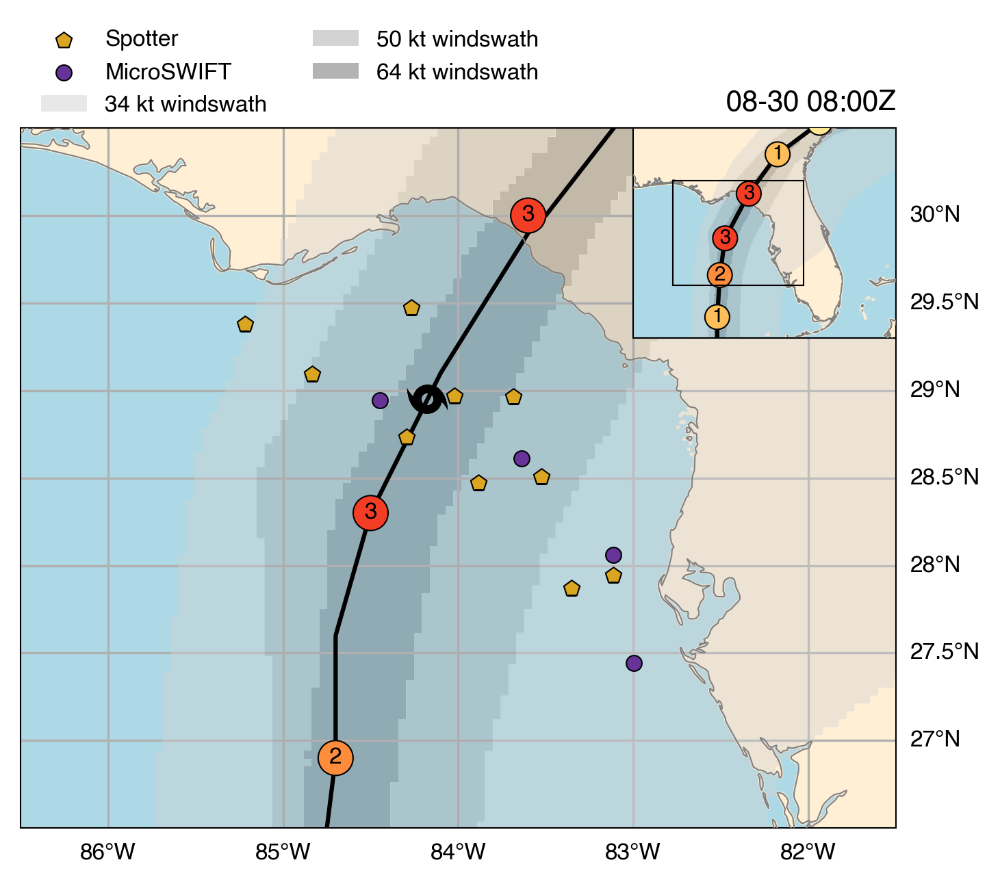

In [23]:
FIG_SIZE = (5.5, 5)
FIG_TITLE = f"idalia_dataset_overview_map"
CRS = cartopy.crs.PlateCarree()

def plot_overview_map(
    ax,
    spotter_df=None,
    microswift_df=None,
    ibtracs_df=None,
    idalia_nhc_geometry=None,
    extent=[-86.5, -81.5, 26.5, 30.5],
    extent_minimap=[-88, -78, 24.5, 32.5],
    annotate_drifters=False,
):
    land_kwargs = {'color': 'papayawhip', 'alpha': 1.0, 'zorder': 0}
    ocean_kwargs = {'color': 'lightblue'}
    annotation_kwargs = dict(ha = 'center', va = 'bottom', fontsize = 10)

    # Plot the base Cartopy map
    plotting.plot_base_chart(
        ax,
        extent,
        land_kwargs=land_kwargs,
        ocean_kwargs=ocean_kwargs,
    )

    # Plot and annotate drifters
    drifter_handles = []
    if spotter_df is not None:
        spotter_plot = plotting.plot_drifter_track(
            spotter_df,
            ax,
            label=plotting.get_drifter_label('spotter'),
            **plotting.spotter_map_kwargs,
        )
        drifter_handles.append(spotter_plot)
        if annotate_drifters:
            spotter_ann = plotting.annotate_drifter(
                spotter_df,
                ax,
                **annotation_kwargs
            )
    else:
        drifter_handles.append(plotting.get_empty_legend_placeholder())

    if microswift_df is not None:
        microswift_plot = plotting.plot_drifter_track(
            microswift_df,
            ax,
            label=plotting.get_drifter_label('microswift'),
            **plotting.microswift_map_kwargs,
        )
        drifter_handles.append(microswift_plot)
        if annotate_drifters:
            microswift_ann = plotting.annotate_drifter(
                microswift_df,
                ax,
                **annotation_kwargs
            )
    else:
        drifter_handles.append(plotting.get_empty_legend_placeholder())

    # Plot ibtracs
    if ibtracs_df is not None:
        ax.plot(
            ibtracs_df['LON'],
            ibtracs_df['LAT'],
            color='k',
            alpha=1,
        )

    # Plot the storm center
    storm_longitude = spotter_df['storm_longitude'].mean()
    storm_latitude = spotter_df['storm_latitude'].mean()
    plotting.plot_hurricane_symbol(
        ax,
        xy=(storm_longitude, storm_latitude),
        annotation_bbox_kwargs={'zorder': 5}
    )

    # Plot best track shapefiles (pass None for lin since ibtracs is used).
    pts_kwargs = {'markersize': 150}
    plotting.plot_best_track(ax, idalia_nhc_geometry[0], None, idalia_nhc_geometry[2], pts_kwargs=pts_kwargs)

    # Create a minimap for context
    ax_inset = plotting.plot_minimap(
        ax,
        extent=extent_minimap,
        land_kwargs=land_kwargs,
        ocean_kwargs=ocean_kwargs
    )

    # Plot minimap best track
    pts_kwargs = {'markersize': 75}
    annotate_pts_kwargs = {'fontsize': 7}
    plotting.plot_best_track(ax_inset, *idalia_nhc_geometry, pts_kwargs=pts_kwargs, annotate_pts_kwargs=annotate_pts_kwargs)

    # Add the inset rectangle to the main map
    ax_inset.add_patch(mpl.patches.Rectangle(
        xy=[extent[0], extent[2]],
        width= extent[1] - extent[0],
        height= extent[3] - extent[2],
        facecolor='none',
        edgecolor='k',
        linewidth=0.5,
        alpha=1,
        zorder=4,
        )
    )
    ax_inset.set_aspect('equal')

    # Create a custom legend representing the windswath geometries
    legend_elements = [
        mpl.patches.Patch(label='34 kt windswath', facecolor='lightgrey', alpha = 0.5, edgecolor='none'),
        mpl.patches.Patch(label='50 kt windswath', facecolor='darkgrey', alpha = 0.5, edgecolor='none'),
        mpl.patches.Patch(label='64 kt windswath', facecolor='dimgrey', alpha = 0.5, edgecolor='none'),
    ]

    ax.legend(
        handles=[*drifter_handles, *legend_elements],
        loc='upper left',
        edgecolor='none',
        ncols=2,
        bbox_to_anchor=(0, 1.17),
        frameon=False,
    ).set_zorder(10)
    ax.set_aspect('equal')


# Plot the map when the buoys are near the storm center.
start_date = pd.Timestamp('2023-08-30T08:00', tz='UTC')
end_date = pd.Timestamp('2023-08-30T09:00', tz='UTC')

fig, ax = plt.subplots(subplot_kw=dict(projection=CRS), figsize=FIG_SIZE)
plot_overview_map(
    ax,
    spotter_df=spotter_df.xs(slice(start_date, end_date), level='time'),
    microswift_df=microswift_df.xs(slice(start_date, end_date), level='time'),
    ibtracs_df=ibtracs_df,
    idalia_nhc_geometry=idalia_nhc_geometry,
)

ax.set_title(f"{start_date.strftime('%m-%d %H:%MZ')}", loc='right')

## Time Series

Plot time series of wind and wave conditions (for a single buoy, `SPOT-30103D`) and storm metrics from IBTrACS.

In [24]:
spotter_id = 'SPOT-30103D'
spotter_subset_df = spotter_df.loc[(spotter_id, time_slice_full), :].droplevel('id')
plot_time_start = pd.Timestamp('2023-08-29T12:00', tz='utc')
plot_time_end = time_slice_full.stop

# All plots use the same drifter and time slice.
time_series_kwargs = dict(
    drifter_df=spotter_subset_df,
    time_slice=time_slice,
)

Define a function to plot time series over the full time slice.  Embolden the shortened time slice, which is used later in the storm-centered reference frame.  Plot metrics related to the storm conditions, derived from models and/or best track, in black.  Plot drifter observables in a color corresponding to the drifter type.

In [25]:
def plot_time_series_overview(
    ax,
    drifter_df,
    y_column_name,
    time_slice_highlight: Optional[slice] = None,
    **kwargs,
) -> Tuple[list[mpl.lines.Line2D], Optional[list[mpl.lines.Line2D]]]:
    """
    Plot `y_column_name` of `drifter_df` as a time series.  Highlight the range
    covered by `time_slice_highlight`, if provided.
    """
    plot_full = plotting.plot_drifter_time_series_line(
        drifter_df,
        ax=ax,
        y_column_name=y_column_name,
        **kwargs,
    )
    if time_slice_highlight is not None:
        plot_highlight = plotting.plot_drifter_time_series_line(
            drifter_df.loc[time_slice_highlight, :],
            ax=ax,
            y_column_name=y_column_name,
            **kwargs,
        )
    else:
        plot_highlight = None

    plotting.remove_top_and_right_spines(ax)
    return plot_full, plot_highlight


Plot a time series of COAMPS-TC 10-m wind speed, at this buoy's location.

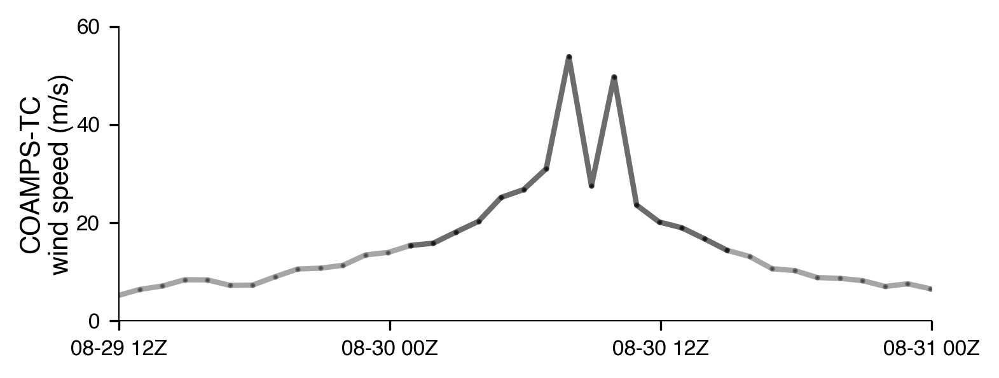

In [26]:
FIG_SIZE = (plotting.figure_full_width, 2)


# coamps wind speed
def plot_coamps_wind_speed_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'wind_speed'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.coamps_time_series_kwargs,
    )
    ax.set_ylim([0, 60])
    ax.set_yticks(np.linspace(0, 60, 4))
    ax.set_ylabel(
        'COAMPS-TC\nwind speed (m/s)',
        labelpad=1,
        fontsize=plotting.normal_font_size,
    )
    plotting.remove_top_and_right_spines(ax)
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_coamps_wind_speed_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of buoy-measured significant wave height.

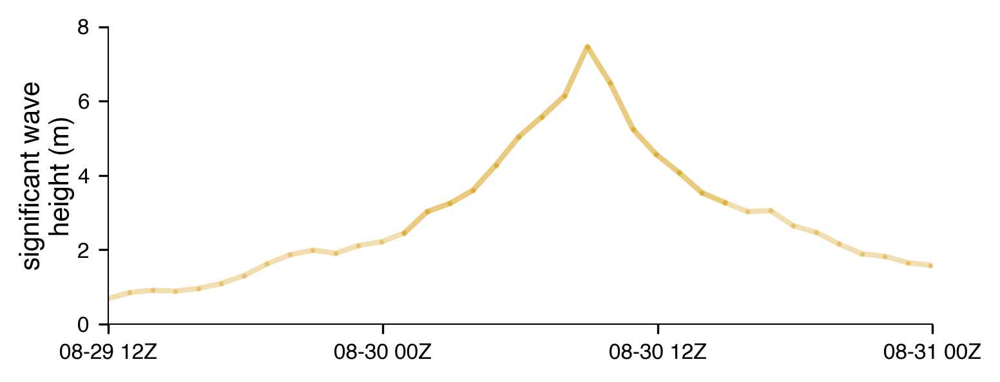

In [27]:
FIG_SIZE = (plotting.figure_full_width, 2)


# significant_height
def plot_significant_height_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'significant_height'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.drifter_time_series_kwargs,
    )
    ax.set_ylim([0, 8])
    ax.set_yticks(np.linspace(0, 8, 5))
    ax.set_ylabel(
        'significant wave\nheight (m)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_significant_height_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of buoy-measured mean square slope (mss).

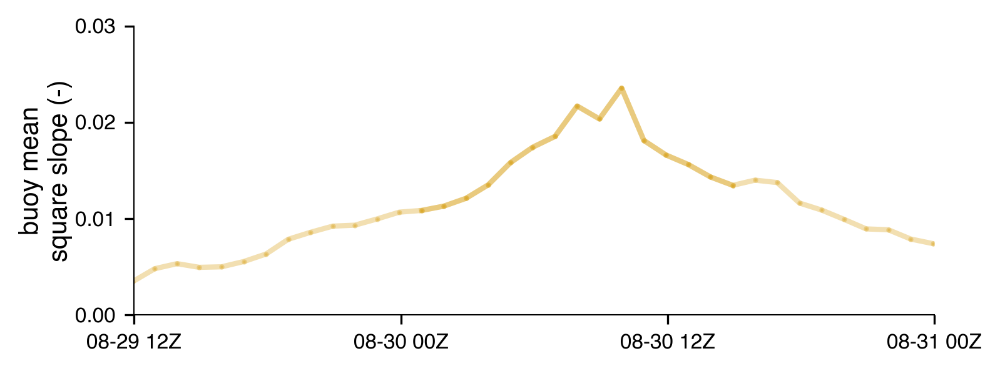

In [28]:
FIG_SIZE = (plotting.figure_full_width, 2)


# mean square slope
def plot_mean_square_slope_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'mean_square_slope_intrinsic'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.drifter_time_series_kwargs,
    )
    ax.set_ylim([0, 0.03])
    ax.set_yticks(np.linspace(0, 0.03, 4))
    ax.set_ylabel(
        'buoy mean\nsquare slope (-)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    plotting.remove_top_and_right_spines(ax)
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_mean_square_slope_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of COAMPS-TC wind direction and buoy-measured (mean/energy-weighted) wave direction.

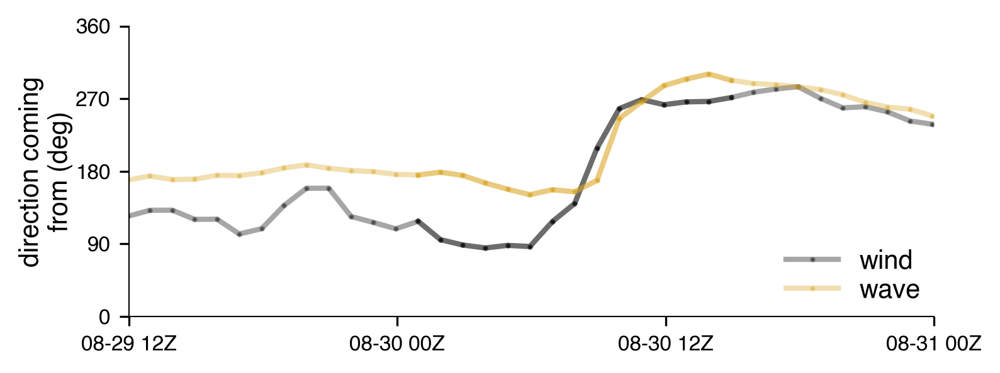

In [29]:
FIG_SIZE = (plotting.figure_full_width, 2)


# wind direction
def plot_wind_wave_direction_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'wind_direction'
    wind_dir_plot_full, wind_dir_plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        label='wind',
        **plotting.coamps_time_series_kwargs,
    )
    y_column_name = 'mean_direction'
    wave_dir_plot_full, wave_dir_plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        label='wave',
        **plotting.drifter_time_series_kwargs,
    )
    ax.set_ylim([0, 360])
    ax.set_yticks(np.linspace(0, 360, 5))
    ax.set_ylabel(
        'direction coming\nfrom (deg)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    plotting.remove_top_and_right_spines(ax)
    ax.legend(
        handles= wind_dir_plot_full + wave_dir_plot_full,
        # bbox_to_anchor=[0.00, 1.15],
        labelspacing=0.15,
        loc='lower right',
        borderpad=0,
        fontsize=plotting.normal_font_size,
        frameon=False,
    )
    return wind_dir_plot_full, wave_dir_plot_full


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_wind_wave_direction_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of Idalia's storm speed (from IBTrACS).

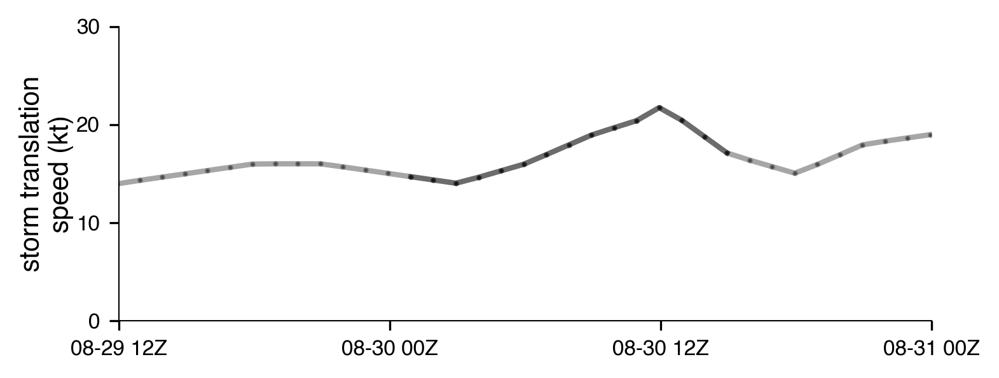

In [30]:
FIG_SIZE = (plotting.figure_full_width, 2)


# storm speed
def plot_storm_speed_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'storm_speed_kt'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.coamps_time_series_kwargs,
    )
    ax.set_ylim([0, 30])
    ax.set_yticks(np.linspace(0, 30, 4))
    ax.set_ylabel(
        'storm translation\nspeed (kt)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    plotting.remove_top_and_right_spines(ax)
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_storm_speed_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of Idalia's RMW (from IBTrACS).

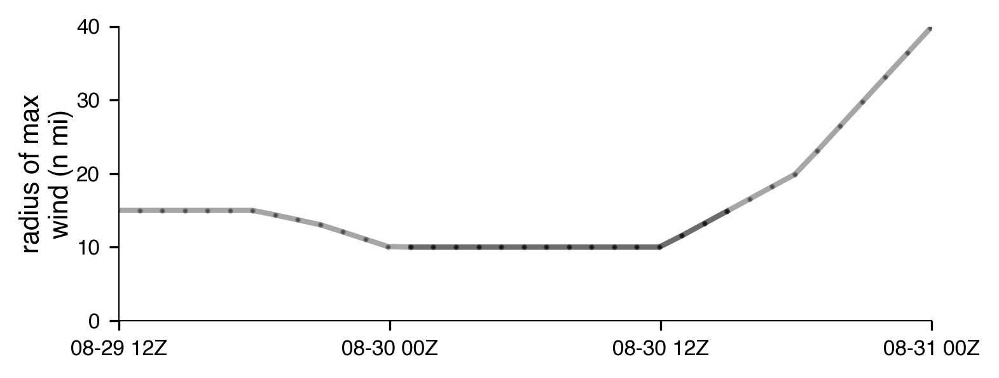

In [31]:
FIG_SIZE = (plotting.figure_full_width, 2)


# storm size
def plot_storm_radius_max_wind_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'storm_radius_max_wind_nmi'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.coamps_time_series_kwargs,
    )
    ax.set_ylim([0, 40])
    ax.set_yticks(np.linspace(0, 40, 5))
    ax.set_ylabel(
        'radius of max\nwind (n mi)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_storm_radius_max_wind_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of Idalia's maximum wind speed (from IBTrACS).

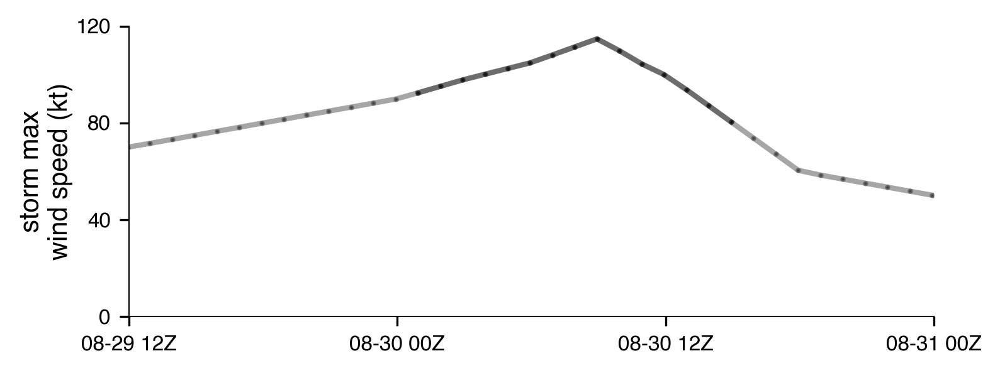

In [32]:
FIG_SIZE = (plotting.figure_full_width, 2)


# storm max wind
def plot_storm_max_wind_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'storm_max_wind_speed_kt'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.coamps_time_series_kwargs,
    )
    ax.set_ylim([0, 120])
    ax.set_yticks(np.linspace(0, 120, 4))
    ax.set_ylabel(
        'storm max\nwind speed (kt)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_storm_max_wind_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

Plot a time series of the Kudryavtsev (2021) trapping criterion based on Idalia's maximum wind speed and radius of maximum wind.

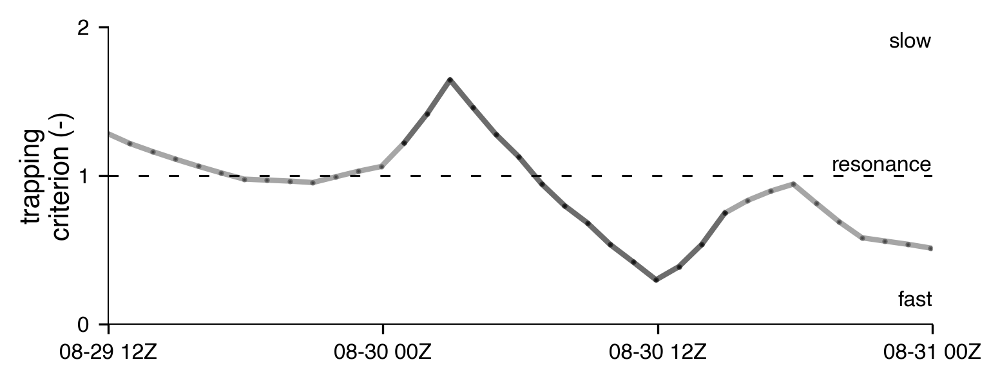

In [33]:
FIG_SIZE = (plotting.figure_full_width, 2)


# trapping criterion
def plot_trapping_criterion_time_series(
    ax,
    drifter_df,
    time_slice,
):
    y_column_name = 'storm_trapping_criterion'
    plot_full, plot_highlight = plot_time_series_overview(
        ax,
        drifter_df=drifter_df,
        y_column_name=y_column_name,
        time_slice_highlight=time_slice,
        **plotting.coamps_time_series_kwargs,
    )
    ax.axhline(1, color='k', linestyle='--', linewidth=0.75, dashes=(5, 10))
    ax.annotate(
        'resonance',
        xy=(1, 0.5),
        xycoords='axes fraction',
        ha='right',
        va='bottom',
        fontsize=plotting.small_font_size
    )
    ax.annotate(
        'slow',
        xy=(1, 0.95),
        xycoords='axes fraction',
        ha='right',
        va='center',
        fontsize=plotting.small_font_size
    )
    ax.annotate(
        'fast',
        xy=(1, 0.08),
        xycoords='axes fraction',
        ha='right',
        va='center',
        fontsize=plotting.small_font_size
    )
    ax.set_ylim([0, 2])
    ax.set_yticks(np.linspace(0, 2, 3))
    ax.set_ylabel(
        'trapping\ncriterion (-)',
        labelpad=1,
        fontsize=plotting.normal_font_size
    )
    return plot_full, plot_highlight


fig, ax = plt.subplots(figsize=FIG_SIZE)
plot_trapping_criterion_time_series(ax=ax, **time_series_kwargs)
plotting.set_time_series_xaxis(ax, plot_time_start, plot_time_end)

## Other maps

### Animated

Create animated maps of COAMPS-TC wind speed and pressure.

In [34]:
def get_timestep(date_range: pd.DatetimeIndex, step: int) -> slice:
    """ Return the time slice for the given step in the date range. """
    start_time = date_range[step]
    end_time = start_time + date_range.freq
    return slice(start_time, end_time)


#### Winds
Create a GIF of the hurricane passing through the buoy array using COAMPS-TC winds.

In [35]:
#TODO: delete?
min_pressure_coords = coamps_ds['mslp'].argmin(dim=('longitude', 'latitude'))
min_pressure_lon = coamps_ds['longitude'].isel(longitude=min_pressure_coords['longitude'])
min_pressure_lat = coamps_ds['latitude'].isel(latitude=min_pressure_coords['latitude'])

In [ ]:
FIG_SIZE = (5, 5)
EXTENT = [-86, -82, 27, 30]
CRS = cartopy.crs.PlateCarree()

# Create a date range for the animation
date_range = pd.date_range(time_slice_full.start, time_slice_full.stop, freq='1h', tz='UTC')

ANIMATION_KWARGS = dict(
    interval=30,
    frames=len(date_range),
    repeat=False
)

fig, ax = plt.subplots(subplot_kw=dict(projection=CRS), figsize=FIG_SIZE)
transform = CRS._as_mpl_transform(ax)
plotting.plot_base_chart(ax, EXTENT)


# Initial start and end time
current_time_slice = get_timestep(date_range, 0)

# Plot COAMPS-TC winds
windfield_plot = plotting.plot_coamps_field(
    coamps_ds.sel(time=current_time_slice.start.tz_localize(None)),
    field_name='ws',
    ax=ax,
    **plotting.wind_speed_plot_kwargs,
)
cax = ax.inset_axes([0.93, 0.5, 0.02, 0.45], axes_class=mpl.axes.Axes)
cbar = plt.colorbar(windfield_plot, cax=cax)
cax.yaxis.set_ticks_position('left')
cbar.set_label('10-m wind speed, $U_{10}$ (m/s)')

# Plot ibtracs
ibtracs_plot = ax.plot(
    spotter_df.loc[('SPOT-30055D', time_slice_full), 'storm_longitude'],
    spotter_df.loc[('SPOT-30055D', time_slice_full), 'storm_latitude'],
    label='best track',
    color='k',
    alpha=0.4,
)

# Plot COAMPS-TC minimum pressure
coamps_min_pressure_plot = ax.plot(
    min_pressure_lon,
    min_pressure_lat,
    label='COAMPS-TC track',
    color='k',
    linestyle='--',
    dashes=(1, 1),
    alpha=0.4,
)

# Plot Spotters
spotter_plot = plotting.plot_drifter_track(
    spotter_df.xs(current_time_slice, level='time'),
    ax,
    label='Spotter',
    **plotting.spotter_map_kwargs,
)

# Plot microSWIFTs
microswift_plot = plotting.plot_drifter_track(
    microswift_df.xs(current_time_slice, level='time'),
    ax,
    label='microSWIFT',
    **plotting.microswift_map_kwargs,
)

def animate(i):
    current_time_slice = get_timestep(date_range, i)
    plotting.update_coamps_field(
        coamps_ds.sel(time=current_time_slice.start.tz_localize(None)),
        field_name='ws',
        plot= windfield_plot
    )
    plotting.update_drifter_track(
        spotter_df.xs(current_time_slice, level='time'),
        spotter_plot,
    )
    plotting.update_drifter_track(
        microswift_df.xs(current_time_slice, level='time'),
        microswift_plot,
    )
    ax.set_title(f"{current_time_slice.start.strftime('%m-%d %H:%MZ')}")

    return windfield_plot, spotter_plot

ax.legend(
    handles=[microswift_plot, spotter_plot, *coamps_min_pressure_plot, *ibtracs_plot],
    loc='lower left',
    fontsize=plotting.small_font_size,
    framealpha=0.3,
    frameon=True,
)

anim = FuncAnimation(fig, animate, **ANIMATION_KWARGS)
fig.tight_layout()

# Display the animation in this notebook.
html = HTML(anim.to_jshtml())
display(html)
plt.close()

# Save the animation as a gif.
# figure_title = (f"coamps-tc_winds")
# anim.save(figure_title + ".gif", dpi=200,
#           writer=mpl.animation.PillowWriter(fps=5))

#### Surface pressure
Create a GIF of the hurricane passing through the buoy array using COAMPS-TC surface pressures.

In [38]:
FIG_SIZE = (5, 5)
EXTENT = [-86, -82, 27, 30]
CRS = cartopy.crs.PlateCarree()
ANIMATION_KWARGS = dict(
    interval=30,
    frames=len(date_range),
    repeat=False
)

# Create a date range for the animation
date_range = pd.date_range(time_slice_full.start, time_slice_full.stop, freq='1h', tz='UTC')

fig, ax = plt.subplots(subplot_kw=dict(projection=CRS), figsize=FIG_SIZE)
transform = CRS._as_mpl_transform(ax)
plotting.plot_base_chart(ax, EXTENT)

# Initial start and end time
current_time_slice = get_timestep(date_range, 0)

# Plot COAMPS-TC winds
pressure_field_plot = plotting.plot_coamps_field(
    coamps_ds.sel(time=current_time_slice.start.tz_localize(None)),
    field_name='mslp',
    ax=ax,
    **plotting.pressure_plot_kwargs,
)
cax = ax.inset_axes([0.93, 0.5, 0.02, 0.45], axes_class=mpl.axes.Axes)
cbar = plt.colorbar(pressure_field_plot, cax=cax)
cax.yaxis.set_ticks_position('left')
cbar.set_label('pressure (mb)')


# Plot ibtracs
ax.plot(
    spotter_df.loc[('SPOT-30055D', time_slice_full), 'storm_longitude'],
    spotter_df.loc[('SPOT-30055D', time_slice_full), 'storm_latitude'],
    color='k',
    alpha=0.3,
)

# Plot Spotters
spotter_plot = plotting.plot_drifter_track(
    spotter_df.xs(current_time_slice, level='time'),
    ax,
    label='Spotter',
    **plotting.spotter_map_kwargs,
)

# Plot microSWIFTs
microswift_plot = plotting.plot_drifter_track(
    microswift_df.xs(current_time_slice, level='time'),
    ax,
    label='microSWIFT',
    **plotting.microswift_map_kwargs,
)

def animate(i):
    current_time_slice = get_timestep(date_range, i)
    plotting.update_coamps_field(
        coamps_ds.sel(time=current_time_slice.start.tz_localize(None)),
        field_name='mslp',
        plot=pressure_field_plot,
    )
    plotting.update_drifter_track(
        spotter_df.xs(current_time_slice, level='time'),
        spotter_plot,
    )
    plotting.update_drifter_track(
        microswift_df.xs(current_time_slice, level='time'),
        microswift_plot,
    )
    ax.set_title(f"{current_time_slice.start.strftime('%m-%d %H:%MZ')}")

    return pressure_field_plot, spotter_plot

ax.legend(handles=[microswift_plot, spotter_plot], loc='lower left', frameon=True)
fig.tight_layout()

anim = FuncAnimation(fig, animate, **ANIMATION_KWARGS)
fig.tight_layout()

# Display the animation in this notebook.
html = HTML(anim.to_jshtml())
display(html)
plt.close()

# Save the animation as a gif.
figure_title = (f"coamps-tc_pressures")
# anim.save(figure_title + ".gif", dpi=100,
#           writer=mpl.animation.PillowWriter(fps=5))


### Bathymetry

Plot a bathymetric chart and overlay the buoy drift tracks.  The bathymetry data (positive up) are from the General Bathymetric Chart of the Oceans (GEBCO).

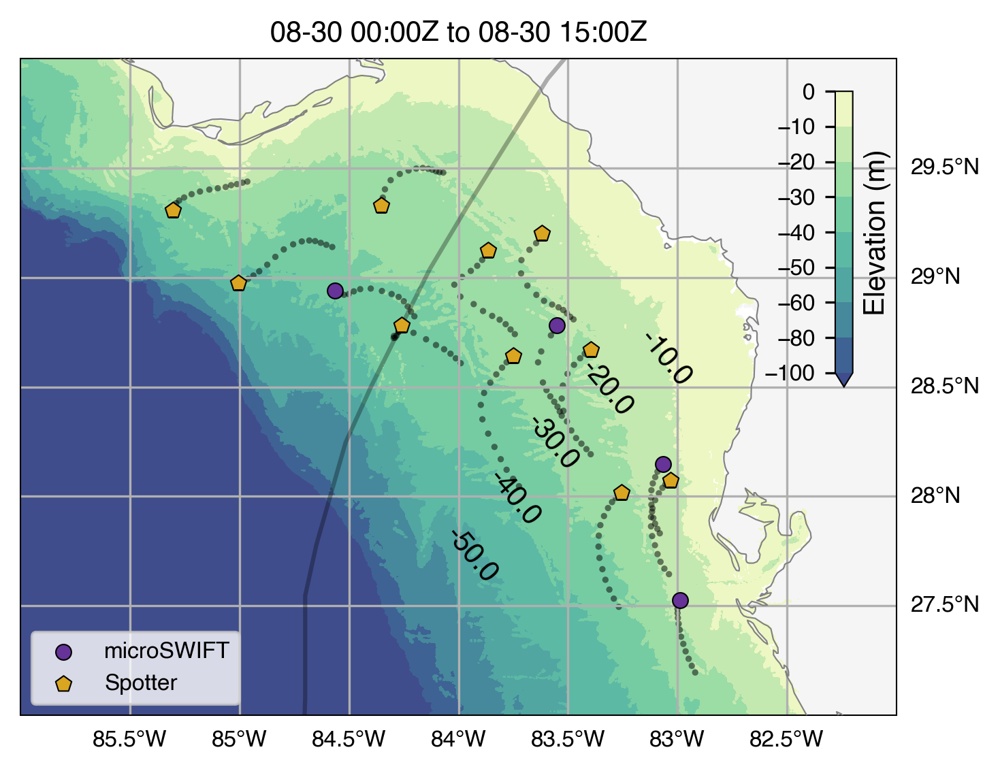

In [39]:
FIG_SIZE = (5, 5)
FIG_TITLE = (f"idalia_spotters_bathymetry_{time_slice.start.strftime('%m-%d_%H%MZ')}"
             f" to {time_slice.stop.strftime('%m-%d %H%MZ')}")
EXTENT = [-86, -82, 27, 30]
CRS = cartopy.crs.PlateCarree()


fig, ax = plt.subplots(subplot_kw=dict(projection=CRS), figsize=FIG_SIZE)
transform = CRS._as_mpl_transform(ax)
plotting.plot_base_chart(ax, EXTENT, land_kwargs=dict(color='whitesmoke', zorder=1, alpha=1))

# Plot bathymetry colormesh and contours.
levels = [-100, -80, -60, -50, -40, -30, -20, -10, 0]
label_levels = [-50, -40, -30, -20, -10]
label_locations = [
    (-84, 27.75),
    (-83.75, 28),
    (-83.5, 28.25),
    (-83.25, 28.5),
    (-83.0, 28.65)
]
bathy_plot = plotting.plot_bathymetry(
    bathymetry_ds,
    levels,
    ax,
    **plotting.bathy_plot_kwargs
)
bathy_contours, bathy_labels = plotting.plot_bathymetry_contours(
    bathymetry_ds,
    label_levels,
    label_locations,
    angle=-50,
    ax=ax,
    **plotting.bathy_contour_kwargs,
)

# Bathymetry colorbar
cax = ax.inset_axes([0.93, 0.5, 0.02, 0.45], axes_class=mpl.axes.Axes)
cbar = plt.colorbar(bathy_plot, cax=cax)
cax.yaxis.set_ticks_position('left')
cbar.set_label('Elevation (m)')

# Plot Spotter drift trails
spotter_plot = plotting.plot_drifter_track(
    spotter_df.xs(time_slice, level='time'),
    ax,
    first_only=False,
    color='k',
    alpha=0.5,
    edgecolor='none',
    s=5,
)

# Plot Spotter marker at the final time
spotter_marker = plotting.plot_drifter_track(
    spotter_df.xs(slice(time_slice.stop - pd.Timedelta('1h'), time_slice.stop), level='time'),
    ax,
    label='Spotter',
    **plotting.spotter_map_kwargs,
)

# Plot microSWIFT drift trails
microswift_plot = plotting.plot_drifter_track(
    microswift_df.xs(time_slice, level='time'),
    ax,
    first_only=False,
    color='k',
    alpha=0.5,
    edgecolor='none',
    s=5,
)

# Plot microSWIFT marker at the final time
microswift_marker = plotting.plot_drifter_track(
    microswift_df.xs(slice(time_slice.stop - pd.Timedelta('1h'), time_slice.stop), level='time'),
    ax,
    label='microSWIFT',
    **plotting.microswift_map_kwargs,
)

# Plot ibtracs
ax.plot(
    spotter_df.loc['SPOT-30025D', 'storm_longitude'],
    spotter_df.loc['SPOT-30025D', 'storm_latitude'],
    color='k',
    alpha=0.3,
)

ax.set_title(f"{time_slice.start.strftime('%m-%d %H:%MZ')} to {time_slice.stop.strftime('%m-%d %H:%MZ')}")
ax.legend(handles=[microswift_marker, spotter_marker], loc='lower left', frameon=True)

fig.tight_layout()
# fig.savefig(FIG_TITLE + '.png', dpi=FIG_RESOLUTION)
plt.show()

## References

Gahtan, J., Knapp, K. R., Schreck, C. J. I., Diamond, H. J., Kossin, J. P., & Kruk, M. C. (2024). International Best Track Archive for Climate Stewardship (IBTrACS) Project (Version 4.01 (Last 3 years)) [Dataset]. NOAA National Centers for Environmental Information. https://doi.org/doi:10.25921/82ty-9e16

Knapp, K. R., Kruk, M. C., Levinson, D. H., Diamond, H. J., & Neumann, C. J. (2010). The International Best Track Archive for Climate Stewardship (IBTrACS): Unifying Tropical Cyclone Data. Bulletin of the American Meteorological Society, 91(3), 363–376. https://doi.org/10.1175/2009BAMS2755.1

Kudryavtsev, V., Yurovskaya, M., & Chapron, B. (2021). Self‐Similarity of Surface Wave Developments Under Tropical Cyclones. Journal of Geophysical Research: Oceans, 126(4), e2020JC016916. https://doi.org/10.1029/2020JC016916
